# Exploring LeRobot Format Dataset

This notebook provides an exploration of the LIBERO dataset in LeRobot format. It demonstrates how to:

- Load the dataset from parquet files
- Inspect dataset structure and features
- Filter episodes by task and episode index
- Visualize episodes with animations

## Kernel Information

**Kernel:** `python3` (venv)

Make sure to select the `python3` kernel with display name "venv310" when running this notebook.

## Dataset Structure
The dataset contains robot demonstrations with the following features:
- `image`: RGB images from the main camera (256x256)
- `wrist_image`: RGB images from the wrist camera (256x256)
- `state`: Robot state vector
- `actions`: Action vectors
- `timestamp`: Timestamp for each frame
- `frame_index`: Frame index within episode
- `episode_index`: Episode identifier
- `task_index`: Task identifier
- `index`: Global dataset index


In [60]:
# Loading the dataset and the tasks

from datasets import load_dataset
import json
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
import matplotlib as mpl
from IPython.display import HTML



# Load all parquet files inside all chunks
ds = load_dataset(
    "parquet",
    data_files="../libero/datasets/lerobot_format/data/*/*.parquet"
    )

print(ds)
print("Number of examples:", len(ds["train"]))


# Map task_index -> human-readable instruction
tasks = {}
with open("../libero/datasets/lerobot_format/meta/tasks.jsonl") as f:
    for line in f:
        row = json.loads(line)
        tasks[row["task_index"]] = row["task"]

DatasetDict({
    train: Dataset({
        features: ['image', 'wrist_image', 'state', 'actions', 'timestamp', 'frame_index', 'episode_index', 'index', 'task_index'],
        num_rows: 273465
    })
})
Number of examples: 273465


In [61]:
# Let's look at one row of the dataset:
example = ds["train"][0]
print("Keys in one example:", example.keys())
print(example)

Keys in one example: dict_keys(['image', 'wrist_image', 'state', 'actions', 'timestamp', 'frame_index', 'episode_index', 'index', 'task_index'])
{'image': <PIL.PngImagePlugin.PngImageFile image mode=RGB size=256x256 at 0x701AB8313DC0>, 'wrist_image': <PIL.PngImagePlugin.PngImageFile image mode=RGB size=256x256 at 0x701AB83106D0>, 'state': [-0.05338004603981972, 0.007029631175100803, 0.6783280968666077, 3.1407692432403564, 0.0017593271331861615, -0.08994418382644653, 0.03878866136074066, -0.03878721222281456], 'actions': [0.01607142947614193, 0.0, -0.0, 0.0, 0.0, -0.0, -1.0], 'timestamp': 0.0, 'frame_index': 0, 'episode_index': 0, 'index': 0, 'task_index': 0}


In [62]:
# Get the target task and episode
example = ds["train"][0]
target_task = example["task_index"]
target_episode = example["episode_index"]

# Find the start index
start_idx = 0
for i, ex in enumerate(ds["train"]):
    if ex["task_index"] == target_task and ex["episode_index"] == target_episode:
        start_idx = i
        break

# Find the end index (consecutive block)
end_idx = start_idx
for i in range(start_idx + 1, len(ds["train"])):
    ex = ds["train"][i]
    if ex["task_index"] != target_task or ex["episode_index"] != target_episode:
        break
    end_idx = i

# Slice the dataset
filtered_ds = ds["train"][start_idx:end_idx + 1]

In [63]:
print('This is the task we will look at:')
tasks[target_task]

This is the task we will look at:


'put the white mug on the left plate and put the yellow and white mug on the right plate'

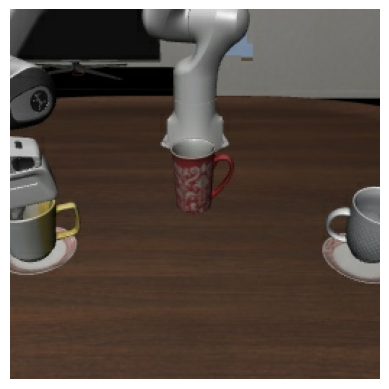

In [59]:
mpl.rcParams['animation.embed_limit'] = 200
# Convert PIL images to numpy arrays once
frames = [np.array(img) for img in filtered_ds['image']]

fig, ax = plt.subplots()
ax.axis('off')  # Hide axes for better display
im = ax.imshow(frames[0])

def update(frame_index):
    im.set_data(frames[frame_index])
    return [im]

# Each frame lasts 0.1 seconds (interval in milliseconds)
anim = FuncAnimation(fig, update, frames=len(frames), interval=100, blit=True)

HTML(anim.to_jshtml())

In [65]:
# Analyze task_index and episode_index distribution (optimized - no loops!)
import pandas as pd

# Extract columns directly - much faster than iterating!
# This loads entire columns at once instead of row-by-row
task_indices = ds["train"]["task_index"]
episode_indices = ds["train"]["episode_index"]

# Create a DataFrame for efficient vectorized operations
df = pd.DataFrame({
    'task_index': task_indices,
    'episode_index': episode_indices
})

# Get unique combinations and group by task_index using pure pandas (no loops!)
unique_combinations = df.drop_duplicates()
task_episode_groups = unique_combinations.groupby('task_index')['episode_index'].apply(lambda x: sorted(x.unique().tolist())).to_dict()

# Sort by task_index for better readability
sorted_tasks = sorted(task_episode_groups.keys())

print(f"Total number of unique task_index values: {len(sorted_tasks)}\n")
print("Task Index | Number of Episodes | Episode Indices")
print("-" * 60)

for task_idx in sorted_tasks:
    episode_indices = task_episode_groups[task_idx]
    num_episodes = len(episode_indices)
    print(f"Task {task_idx:2d}    | {num_episodes:3d} episodes        | {episode_indices}")

# Summary statistics
print("\n" + "=" * 60)
print("Summary:")
print(f"Total unique task_index values: {len(sorted_tasks)}")
print(f"Total unique episode_index values across all tasks: {sum(len(episodes) for episodes in task_episode_groups.values())}")
print(f"Average episodes per task: {sum(len(episodes) for episodes in task_episode_groups.values()) / len(sorted_tasks):.2f}")
print(f"Min episodes per task: {min(len(episodes) for episodes in task_episode_groups.values())}")
print(f"Max episodes per task: {max(len(episodes) for episodes in task_episode_groups.values())}")


Total number of unique task_index values: 40

Task Index | Number of Episodes | Episode Indices
------------------------------------------------------------
Task  0    |  38 episodes        | [0, 18, 22, 33, 58, 85, 88, 105, 107, 114, 121, 125, 129, 157, 167, 170, 190, 207, 211, 231, 233, 235, 236, 247, 249, 257, 264, 267, 295, 301, 307, 309, 315, 323, 343, 346, 362, 367]
Task  1    |  36 episodes        | [1, 4, 5, 11, 19, 21, 37, 52, 62, 68, 108, 110, 113, 130, 138, 146, 152, 168, 176, 197, 206, 210, 212, 216, 220, 224, 242, 248, 252, 271, 302, 322, 325, 355, 356, 369]
Task  2    |  34 episodes        | [2, 3, 34, 35, 44, 59, 80, 84, 99, 123, 126, 139, 140, 142, 145, 164, 173, 178, 186, 193, 217, 226, 230, 245, 269, 276, 282, 285, 312, 324, 339, 342, 357, 365]
Task  3    |  41 episodes        | [6, 38, 40, 45, 48, 49, 50, 66, 72, 87, 93, 95, 134, 150, 153, 162, 182, 184, 185, 202, 203, 218, 225, 239, 240, 243, 253, 259, 263, 272, 277, 278, 287, 292, 303, 321, 345, 351, 354, 358, 361]